<a href="https://colab.research.google.com/github/GuruurajD/AI4ICPS-Learning/blob/main/Computer_Vision_Deep_learning.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

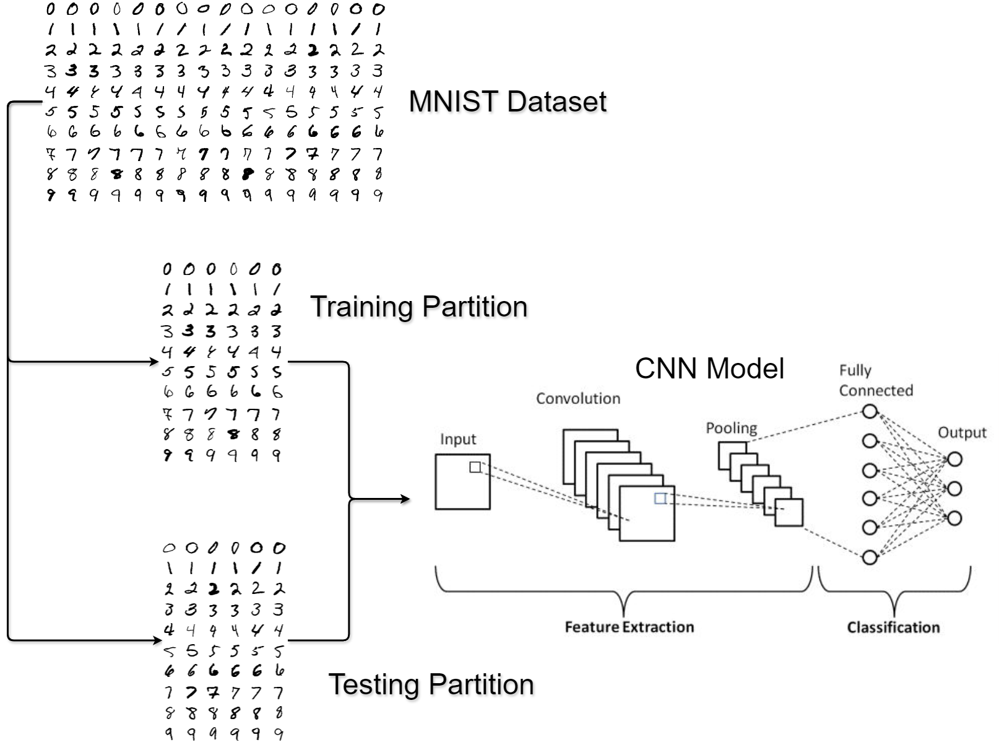

In [1]:
#need to get data loaded
from google.colab import files
uploaded = files.upload()



Saving t10k-images-idx3-ubyte to t10k-images-idx3-ubyte
Saving t10k-images-idx3-ubyte.gz to t10k-images-idx3-ubyte.gz
Saving t10k-labels-idx1-ubyte to t10k-labels-idx1-ubyte
Saving t10k-labels-idx1-ubyte.gz to t10k-labels-idx1-ubyte.gz
Saving train-images-idx3-ubyte to train-images-idx3-ubyte
Saving train-images-idx3-ubyte.gz to train-images-idx3-ubyte.gz
Saving train-labels-idx1-ubyte to train-labels-idx1-ubyte
Saving train-labels-idx1-ubyte.gz to train-labels-idx1-ubyte.gz


In [2]:
#Import the image
from skimage import io
from google.colab import files
uploaded = files.upload()

#my_image = io.imread("my_image.jpg")

Saving my_image.jpg to my_image.jpg


In [5]:
my_image = io.imread("my_image.jpg")
print(f'datatype = {my_image.dtype}')
print(f'Value Range ={2**8}')
print(f'Dimension = {my_image.shape}')
print('Image numpy array : ')
print(my_image)

datatype = uint8
Value Range =256
Dimension = (622, 1001, 3)
Image numpy array : 
[[[154 217 234]
  [154 217 234]
  [154 217 234]
  ...
  [163  73 163]
  [163  73 163]
  [163  73 163]]

 [[154 217 234]
  [154 217 234]
  [154 217 234]
  ...
  [163  73 163]
  [163  73 163]
  [163  73 163]]

 [[154 217 234]
  [154 217 234]
  [154 217 234]
  ...
  [163  73 163]
  [163  73 163]
  [163  73 163]]

 ...

 [[154 217 234]
  [154 217 234]
  [154 217 234]
  ...
  [ 35 177  77]
  [ 35 177  77]
  [ 35 177  77]]

 [[154 217 234]
  [154 217 234]
  [154 217 234]
  ...
  [ 35 177  77]
  [ 35 177  77]
  [ 35 177  77]]

 [[154 217 234]
  [154 217 234]
  [154 217 234]
  ...
  [ 35 177  77]
  [ 35 177  77]
  [ 35 177  77]]]


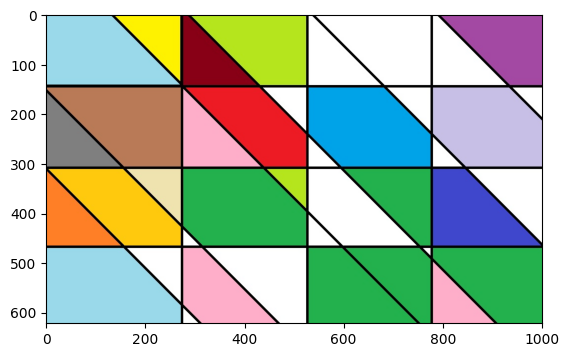

In [6]:
#Display this image
from matplotlib import pyplot as plt
plt.imshow(my_image)

In [8]:
#Features of Image
print(my_image.min(),my_image.max())

0 255


In [11]:
#Since image has values in integer format - mathematical operations will be difficult - so convert it to float
from skimage import img_as_float
my_flt_image = img_as_float(my_image)
print(my_flt_image.min(),my_flt_image.max())
print(f'Datatype = {my_flt_image.dtype}')

0.0 1.0
Datatype = float64


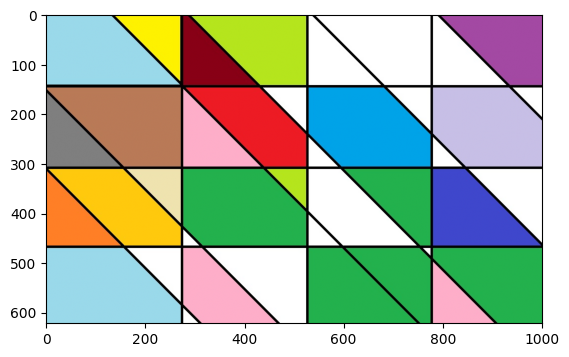

In [12]:
#print image


plt.imshow(my_flt_image)

In [13]:
#Simple math operation on image
my_dark_image = my_flt_image.copy() #Save copy of original image into another image
my_dark_image = my_dark_image *0.5
print(my_dark_image.min(),my_dark_image.max())

0.0 0.5


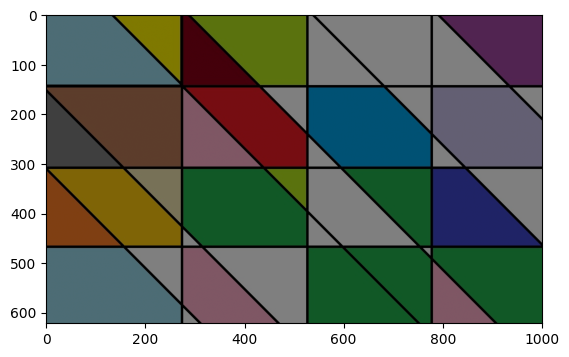

In [14]:
plt.imshow(my_dark_image)

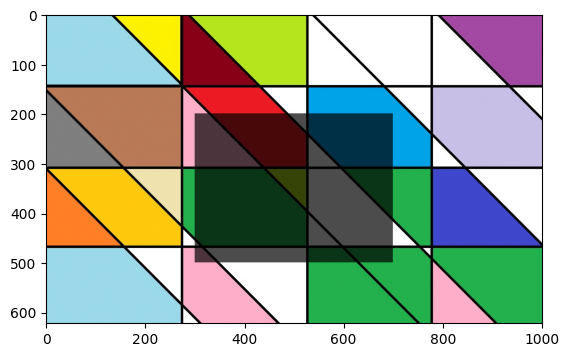

In [16]:
#Implementing simple filter -  What is filter - its the section of image with specified size HxW
my_filter_image = my_flt_image.copy()
my_filter_image[200:500,300:700,:]=my_filter_image[200:500,300:700,:]*0.3

plt.imshow(my_filter_image)

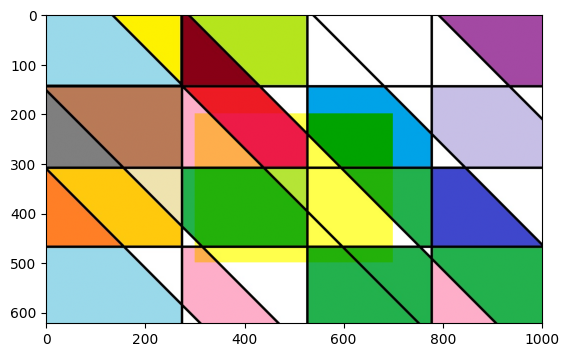

In [18]:
my_filter_image= my_flt_image.copy()
my_filter_image [200:500,300:700,2] = my_filter_image[200:500,300:700,0]*0.3
plt.imshow(my_filter_image)

In [20]:
# Sliding filter creation
sld_filter_image = my_flt_image.copy()
#Check height, width
height,width,depth =sld_filter_image.shape
print(height,width,depth)

622 1001 3


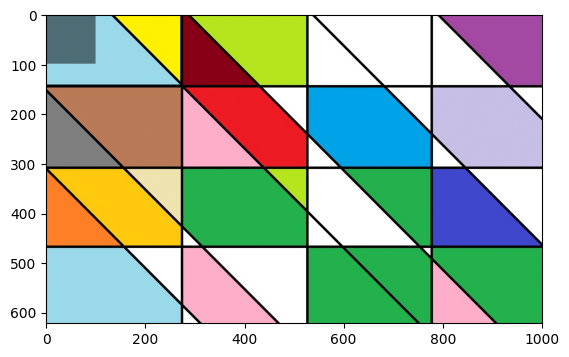

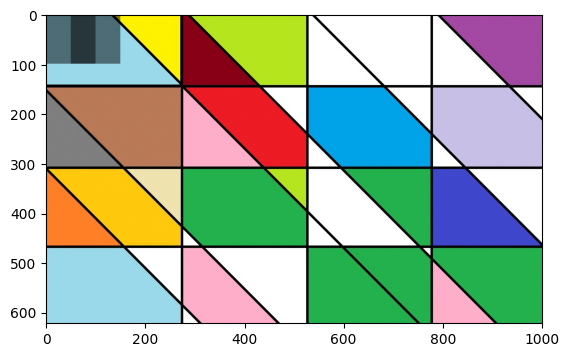

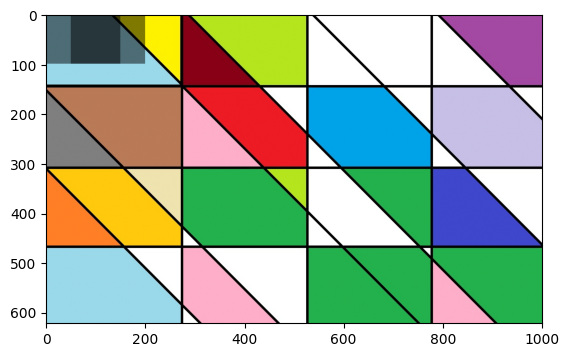

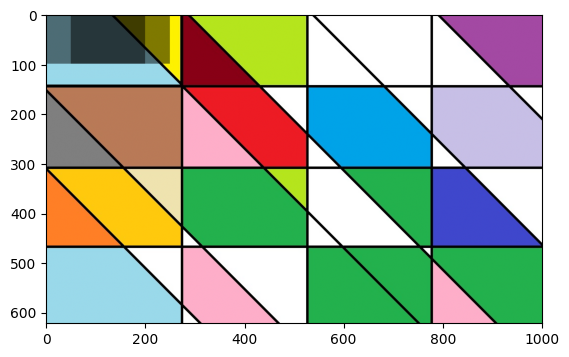

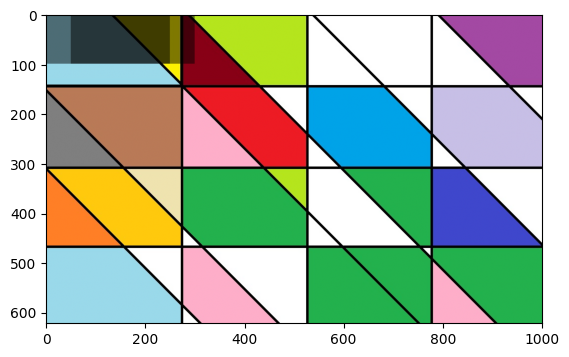

...

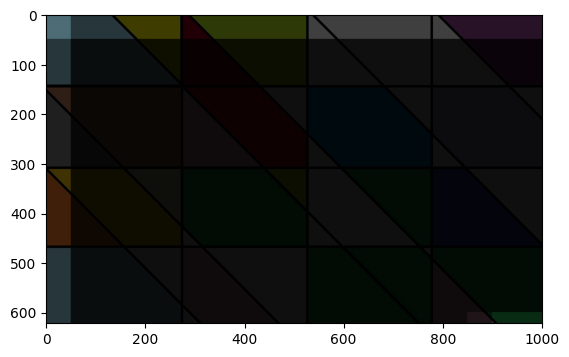

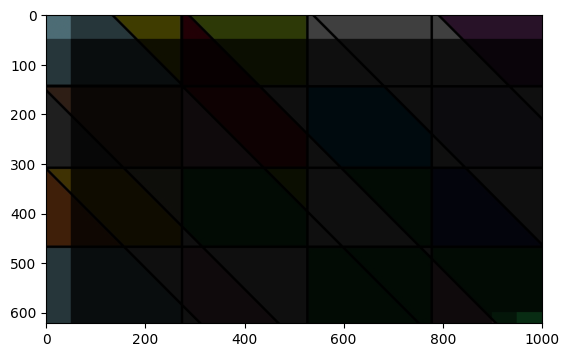

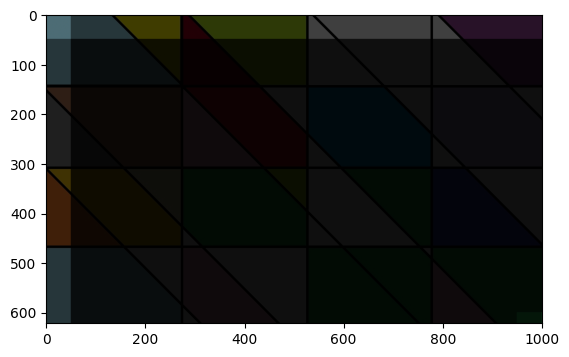

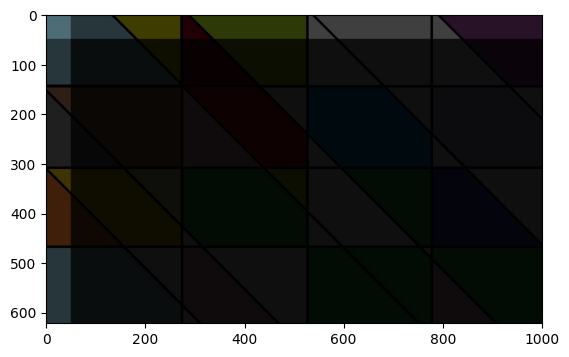

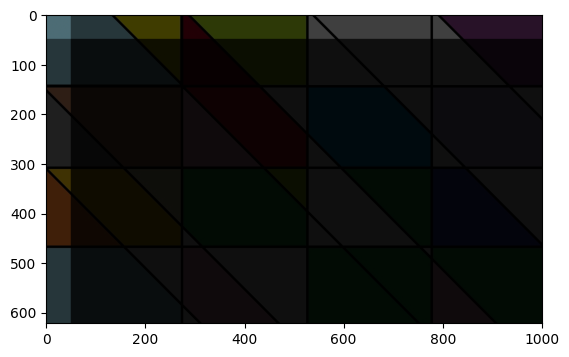

In [21]:
# Sliding Filter demo - slide the filter with stride 50 (horizantal and vertical )
import time
from matplotlib.pyplot import imshow, show
sld_filter_image =my_flt_image.copy()
h_stride =50
v_stride =50
filter_size = 100
for i in range (0,height,v_stride):
  for j in range(0,width,h_stride):
    sld_filter_image[i:i+filter_size,j:j+filter_size,:] = sld_filter_image[i:i+filter_size,j:j+filter_size,:]*0.5
    imshow(sld_filter_image)
    show()
    time.sleep(1)

# **AlexNet**
AlexNet is the name of a convolutional neural network (CNN) architecture, designed by Alex Krizhevsky in collaboration with Ilya Sutskever and Geoffrey Hinton, who was Krizhevsky's Ph.D. advisor at the University of Toronto.

The three formed team SuperVision and submitted AlexNet in the ImageNet Large Scale Visual Recognition Challenge on September 30, 2012. The network achieved a top-5 error of 15.3%, more than 10.8 percentage points lower than that of the runner up. The original paper's primary result was that the depth of the model was essential for its high performance, which was computationally expensive, but made feasible due to the utilization of graphics processing units (GPUs) during training.

Source: Wikipedia

THis has two distinct sections - Feature extraction section and classification section - which is dense \fully connected layer

In [4]:
#Importing required libraries - Predominantly PyTorch
import sys
import torch
import torch.nn as nn
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torch.autograd as Variable
import torch.nn.functional as F
from torchsummary import summary

In [31]:
#seeding for getting same output
torch.manual_seed(42)

In [32]:
#Loading MINST Dataset - Mount drive - Loading directly is very tricky
from google.colab import drive
drive.mount('/content/drive')


Mounted at /content/drive


In [5]:
#Load data from google drive
data_path = './content/drive/MyDrive/data'

trans = transforms.Compose([transforms.ToTensor(),transforms.Normalize((0.5,),(1.0,))])
full_train_set = dset.MNIST(root = data_path, train=True,transform= trans, download =True )
full_test_set = dset.MNIST(root = data_path, train=False, transform = trans )
batch_size = 16 # What is this ? this is system dependent - increase system resources based on increase of this parameter.

100%|██████████| 9.91M/9.91M [00:00<00:00, 16.1MB/s]
100%|██████████| 28.9k/28.9k [00:00<00:00, 477kB/s]
100%|██████████| 1.65M/1.65M [00:00<00:00, 4.41MB/s]
100%|██████████| 4.54k/4.54k [00:00<00:00, 8.28MB/s]


In [6]:
for i in full_train_set:
  print(i)
  break

(tensor([[[-0.5000, -0.5000, -0.5000, -0.5000, -0.5000, -0.5000, -0.5000,
          -0.5000, -0.5000, -0.5000, -0.5000, -0.5000, -0.5000, -0.5000,
          -0.5000, -0.5000, -0.5000, -0.5000, -0.5000, -0.5000, -0.5000,
          -0.5000, -0.5000, -0.5000, -0.5000, -0.5000, -0.5000, -0.5000],
         [-0.5000, -0.5000, -0.5000, -0.5000, -0.5000, -0.5000, -0.5000,
          -0.5000, -0.5000, -0.5000, -0.5000, -0.5000, -0.5000, -0.5000,
          -0.5000, -0.5000, -0.5000, -0.5000, -0.5000, -0.5000, -0.5000,
          -0.5000, -0.5000, -0.5000, -0.5000, -0.5000, -0.5000, -0.5000],
         [-0.5000, -0.5000, -0.5000, -0.5000, -0.5000, -0.5000, -0.5000,
          -0.5000, -0.5000, -0.5000, -0.5000, -0.5000, -0.5000, -0.5000,
          -0.5000, -0.5000, -0.5000, -0.5000, -0.5000, -0.5000, -0.5000,
          -0.5000, -0.5000, -0.5000, -0.5000, -0.5000, -0.5000, -0.5000],
         [-0.5000, -0.5000, -0.5000, -0.5000, -0.5000, -0.5000, -0.5000,
          -0.5000, -0.5000, -0.5000, -0.5000, -

5
torch.Size([28, 28])
0
torch.Size([28, 28])


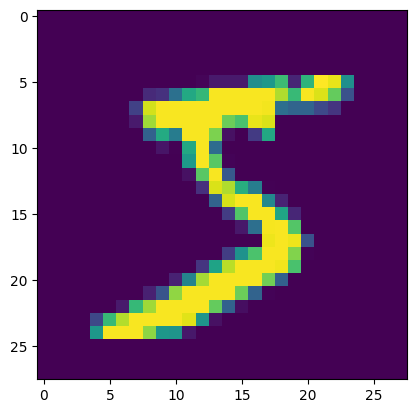

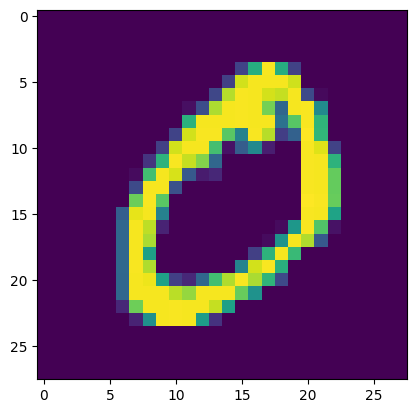

In [9]:
  #Display this data
  from matplotlib import pyplot as plt

  show = 2
  max_show = show
  for i in full_train_set:
    current_image = i[0][0]
    print(i[1]) #class lable of this image
    plt.figure(max_show+1-show)
    plt.imshow(current_image)
    print(current_image.shape)
    show -= 1
    if show == 0:
      break


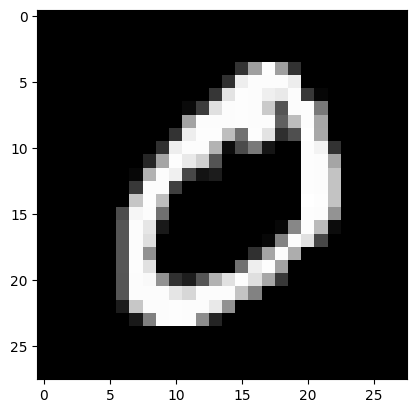

In [10]:
plt.imshow(current_image, cmap ='gray') #Printing of the grayscale image?

In [11]:
#Using the data loader
#torch functionality

train_loader = torch.utils.data.DataLoader(dataset = full_train_set,batch_size=batch_size,shuffle=False)
test_loader = torch.utils.data.DataLoader(dataset = full_test_set,batch_size=batch_size,shuffle = False)

AlexNet Architecture
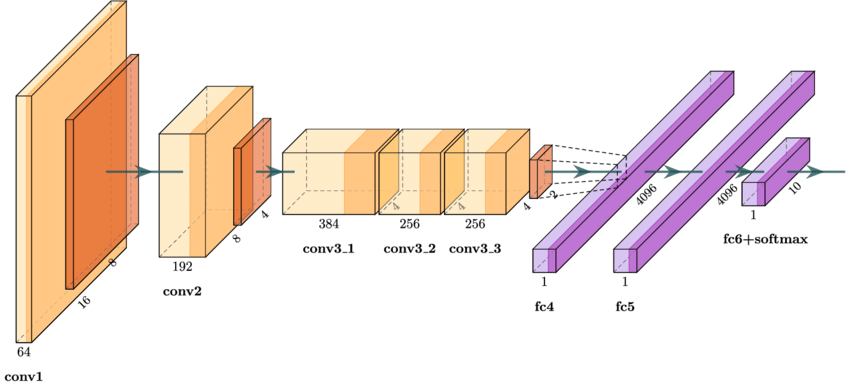

Output of this architecture is 1X10 = so basically it will be class for each digit of MNIST dataset

Lets represent this into format that's understandble to us.
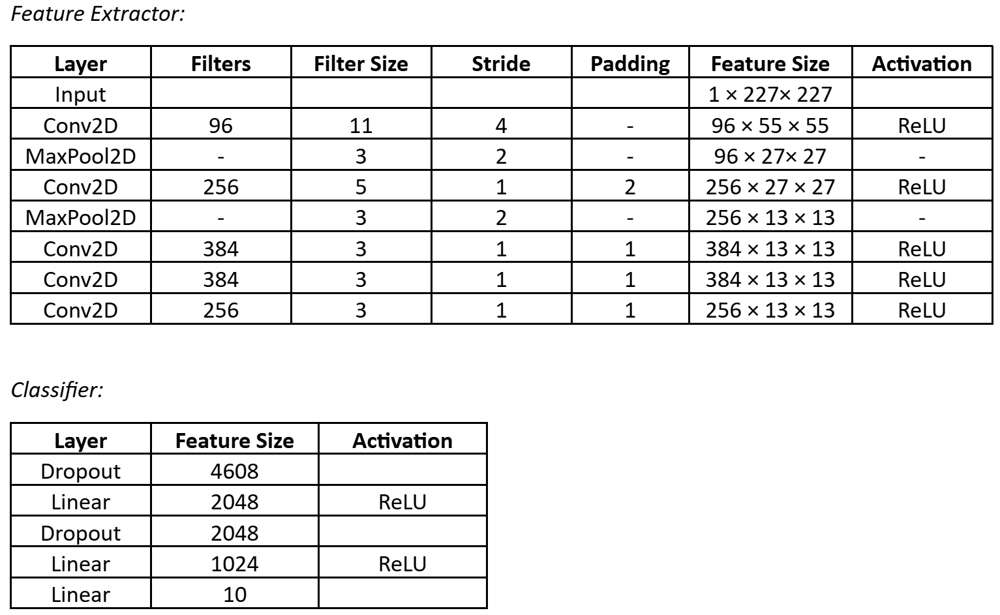

In [ ]:
#building the trimmed version of AlexNet
#since input is 27x27 image we will skip to first Conv2d and Maxpool layer and directly code next conv2d layer
class AlexNet(nn.Module):
  def __init__(self, num=10):
    super(AlexNet,self).__init__()
    self.Features = nn.Sequential(
        nn.Conv2d(1,256,kernel_size = 5,stride =1,padding= 2),
        nn.ReLU(inplace=True),
        nn.MaxPool2d(kernel_size=3, stride =2),
        nn.Conv2d(256,384,kernel_size=3, stride=1, padding=1),
        nn.ReLU(inplace=True),
        nn.Conv2d(384,384,kernel_size=3,stride=1, padding=1),
        nn.ReLU(inplace=True),
        nn.Conv2d(384,256,kernel_size=3,stride=1, padding=1),
        nn.ReLU(inplace=True)
    )
    self.classifier = nn.Sequential(
        nn.Dropout(),
        nn.Linear(256*13*13,2048),
        nn.ReLU(inplace=True),
        nn.Dropout(),
        nn.Linear(2048,1024),
        nn.ReLU(inplace=True),
        nn.Linear(1024,num)
    )

  def forward(self,x):
    x = self.feature(x)
    #x = x.view(-1,256*13*13)
    #x = self.classifier(x)
    return x